# nuScenes devkit tutorial

Welcome to the nuScenes tutorial. This demo assumes the database itself is available at `/data/sets/nuscenes`, and loads a mini version of the full dataset.

## A Gentle Introduction to nuScenes

In this part of the tutorial, let us go through a top-down introduction of our database. Our dataset comprises of elemental building blocks that are the following:

1. `log` - Log information from which the data was extracted.
2. `scene` - 20 second snippet of a car's journey.
3. `sample` - An annotated snapshot of a scene at a particular timestamp.
4. `sample_data` - Data collected from a particular sensor.
5. `ego_pose` - Ego vehicle poses at a particular timestamp.
6. `sensor` - A specific sensor type.
7. `calibrated sensor` - Definition of a particular sensor as calibrated on a particular vehicle.
8. `instance` - Enumeration of all object instance we observed.
9. `category` - Taxonomy of object categories (e.g. vehicle, human).
10. `attribute` - Property of an instance that can change while the category remains the same.
11. `visibility` - Fraction of pixels visible in all the images collected from 6 different cameras.
12. `sample_annotation` - An annotated instance of an object within our interest.
13. `map` - Map data that is stored as binary semantic masks from a top-down view.

The database schema is visualized below. For more information see the [nuScenes schema](https://github.com/nutonomy/nuscenes-devkit/blob/master/docs/schema_nuscenes.md) page.
![](https://www.nuscenes.org/public/images/nuscenes-schema.svg)

## Google Colab (optional)

<br>
<a href="https://colab.research.google.com/github/nutonomy/nuscenes-devkit/blob/master/python-sdk/tutorials/nuscenes_tutorial.ipynb">
    <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab" align="left">
</a>
<br>

If you are running this notebook in Google Colab, you can uncomment the cell below and run it; everything will be set up nicely for you. Otherwise, manually set up everything.

In [ ]:
!mkdir -p /data/sets/nuscenes  # Make the directory to store the nuScenes dataset in.

!wget https://www.nuscenes.org/data/v1.0-mini.tgz  # Download the nuScenes mini split.

!tar -xf v1.0-mini.tgz -C /data/sets/nuscenes  # Uncompress the nuScenes mini split.

!pip install nuscenes-devkit &> /dev/null  # Install nuScenes.

--2023-07-30 19:30:04--  https://www.nuscenes.org/data/v1.0-mini.tgz
Resolving www.nuscenes.org (www.nuscenes.org)... 99.84.203.77, 99.84.203.29, 99.84.203.41, ...
Connecting to www.nuscenes.org (www.nuscenes.org)|99.84.203.77|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4167696325 (3.9G) [application/x-tar]
Saving to: ‘v1.0-mini.tgz.1’

v1.0-mini.tgz.1     100%[===================>]   3.88G  59.7MB/s    in 46s     

2023-07-30 19:30:50 (86.9 MB/s) - ‘v1.0-mini.tgz.1’ saved [4167696325/4167696325]



## Initialization

In [ ]:
# Mahmoud
import os
import cv2 as cv
from datetime import datetime

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
# Utils:
def plot_line(y_data=None, x_data=None, name=""):
  if x_data is None:
    x_data = list(range(len(y_data)))

  assert y_data is not None, f"y_data should have iterative value: {str(type(y_data))} is not allowed"
  fig = go.Figure(
      layout=go.Layout(
          plot_bgcolor="rgba(0, 0, 0, 1)", paper_bgcolor="rgba(70, 10, 10, 1)",
      )
  )

  fig.add_trace(go.Scatter(x=x_data, y=y_data, name=name,
                        marker=dict(color="white")))

  for i in range(len(x_data)):
      fig.add_annotation(
          x=x_data[i], y=y_data[i], text="o", showarrow=False, font=dict(color="white", size=20)
      )

  fig.update_layout(
      xaxis=dict(color="white"),
      yaxis=dict(color="white"),
  )

  return fig

def convert_timestamp(ts, ref):
    """
    Convert a timestamp to a datetime object.

    Args:
        ts (int): The timestamp in milliseconds.
        ref (int): The reference timestamp in milliseconds.

    Returns:
        datetime: The datetime object.
    """

    timestamp = ts / 1e6  # microseconds to seconds
    dt_obj = datetime.fromtimestamp(ref / 1e6)
    return dt_obj

def create_video(file_names, out_path):
  img_array = []
  for filename in file_names:
      file_path = os.path.join(cam_front_path, filename)
      img = cv.imread(file_path)
      height, width, layers = img.shape
      size = (width,height)
      img_array.append(img)


  out = cv.VideoWriter(out_path,cv.VideoWriter_fourcc(*'DIVX'), 15, size)

  for i in range(len(img_array)):
      out.write(img_array[i])
  out.release()

def display_video(vid_path):
  """
  Displays a video in an Ipynb file.

  Args:
    vid_path: The path to the video file.

  Returns:
    None.

  **Optimizations:**
    - Use `display.HTML` to display the video in Ipynb files.
  """

  out_path = vid_path.split('.')[0] + '.mp4'
  # convert video extenstion from .avi to .mp4
  os.system(f"ffmpeg -i {vid_path} -y {out_path}")

  mp4 = open(out_path, 'rb').read()
  data_url = "data:video/mp4;base64," + base64.b64encode(mp4).decode()

  display(HTML("""
  <video controls width="1080" height="576">
        <source src="%s" type="video/mp4">
  </video>
  """ % data_url))

In [ ]:
%matplotlib inline
from nuscenes.nuscenes import NuScenes

nusc = NuScenes(version='v1.0-mini', dataroot='/data/sets/nuscenes', verbose=True)

Loading NuScenes tables for version v1.0-mini...
23 category,
8 attribute,
4 visibility,
911 instance,
12 sensor,
120 calibrated_sensor,
31206 ego_pose,
8 log,
10 scene,
404 sample,
31206 sample_data,
18538 sample_annotation,
4 map,
Done loading in 2.118 seconds.
Reverse indexing ...
Done reverse indexing in 0.1 seconds.


## A look at the dataset

### 1. `scene`

nuScenes is a large scale database that features annotated samples across ***1000 scenes*** of approximately 20 seconds each. Let's take a look at the scenes that we have in the loaded database.

```
scene {
   "token":                   <str> -- Unique record identifier.
   "name":                    <str> -- Short string identifier.
   "description":             <str> -- Longer description of the scene.
   "log_token":               <str> -- Foreign key. Points to log from where the data was extracted.
   "nbr_samples":             <int> -- Number of samples in this scene.
   "first_sample_token":      <str> -- Foreign key. Points to the first sample in scene.
   "last_sample_token":       <str> -- Foreign key. Points to the last sample in scene.
}
```

In [ ]:
nusc.list_scenes()

scene-0061, Parked truck, construction, intersectio... [18-07-24 03:28:47]   19s, singapore-onenorth, #anns:4622
scene-0103, Many peds right, wait for turning car, ... [18-08-01 19:26:43]   19s, boston-seaport, #anns:2046
scene-0655, Parking lot, parked cars, jaywalker, be... [18-08-27 15:51:32]   20s, boston-seaport, #anns:2332
scene-0553, Wait at intersection, bicycle, large tr... [18-08-28 20:48:16]   20s, boston-seaport, #anns:1950
scene-0757, Arrive at busy intersection, bus, wait ... [18-08-30 19:25:08]   20s, boston-seaport, #anns:592
scene-0796, Scooter, peds on sidewalk, bus, cars, t... [18-10-02 02:52:24]   20s, singapore-queensto, #anns:708
scene-0916, Parking lot, bicycle rack, parked bicyc... [18-10-08 07:37:13]   20s, singapore-queensto, #anns:2387
scene-1077, Night, big street, bus stop, high speed... [18-11-21 11:39:27]   20s, singapore-hollandv, #anns:890
scene-1094, Night, after rain, many peds, PMD, ped ... [18-11-21 11:47:27]   19s, singapore-hollandv, #anns:1762
sc

Let's look at a scene metadata

In [ ]:
my_scene = nusc.scene[0]
my_scene

{'token': 'cc8c0bf57f984915a77078b10eb33198',
 'log_token': '7e25a2c8ea1f41c5b0da1e69ecfa71a2',
 'nbr_samples': 39,
 'first_sample_token': 'ca9a282c9e77460f8360f564131a8af5',
 'last_sample_token': 'ed5fc18c31904f96a8f0dbb99ff069c0',
 'name': 'scene-0061',
 'description': 'Parked truck, construction, intersection, turn left, following a van'}

In [ ]:
#all scenes nbr samples per scene
nbr_samples = []
for i in range(10):
  nbr_samples.append(nusc.scene[i]['nbr_samples'])
print(f"all scenes nbr samples per scene: {nbr_samples} ")

all scenes nbr samples per scene: [39, 40, 41, 41, 41, 40, 41, 41, 40, 40] 


### 2. `sample`

```
sample {
   "token":                   <str> -- Unique record identifier.
   "timestamp":               <int> -- Unix time stamp.
   "scene_token":             <str> -- Foreign key pointing to the scene.
   "next":                    <str> -- Foreign key. Sample that follows this in time. Empty if end of scene.
   "prev":                    <str> -- Foreign key. Sample that precedes this in time. Empty if start of scene.
}
```

In scenes, we annotate our data every half a second (2 Hz).

We define `sample` as an ***annotated keyframe of a scene at a given timestamp***. A keyframe is a frame where the time-stamps of data from all the sensors should be very close to the time-stamp of the sample it points to.

Now, let us look at the first annotated sample in this scene.

In [ ]:
first_sample_token = my_scene['first_sample_token'] # ca9a282c9e77460f8360f564131a8af5
last_sample_token = my_scene['last_sample_token']   # ed5fc18c31904f96a8f0dbb99ff069c0
# The rendering command below is commented out because it tends to crash in notebooks
# nusc.render_sample(first_sample_token)

In [ ]:
# count number of samples in scene
# Validate sample['next'] value for all sample in scene
# Number of samples in scene 0: 39
sample_tokens_nxt = []
cur_sample = first_sample_token
while cur_sample != '':
  print(cur_sample)
  sample_tokens_nxt.append(cur_sample)
  my_sample = nusc.get('sample', cur_sample)
  cur_sample = my_sample['next']

print(f"Number of samples in scene 0: {len(sample_tokens_nxt)}")

ca9a282c9e77460f8360f564131a8af5
39586f9d59004284a7114a68825e8eec
356d81f38dd9473ba590f39e266f54e5
e0845f5322254dafadbbed75aaa07969
c923fe08b2ff4e27975d2bf30934383b
f1e3d9d08f044c439ce86a2d6fcca57b
4f545737bf3347fbbc9af60b0be9a963
7626dde27d604ac28a0240bdd54eba7a
be99ffc878b24aca8956bbb4e0f97d0c
9813c23a5f1448b09bb7910fea9baf20
023c4df2d451409881d8e6ea82f14704
c235638ed66145988d17f9d0601923f2
bc3c8a953f6b4dcdb77b521d89f3d9d5
1e3d79dae62742a0ad64c91679863358
2afb9d32310e4546a71cbe432911eca2
cd21dbfc3bd749c7b10a5c42562e0c42
88449a5cb1644a199c1c11f6ac034867
2ff86dc19c4644a1a88ce5ba848f56e5
bf2938e43c6f487497cda76b51bfc406
b26e791522294bec90f86fd72226e35c
c844bf5a9f2243ff8f4bf2c85fe218ff
fedfb3a6cb804635a0f47143f9ca8d6f
965f6af5a92449348409029a5f048a38
4711bcd34644420da8bc77163431888e
a34fabc7aa674713b71f98ec541eb2d4
c78067571d104caba7c568a847d56971
4246e57f018745c9b2bc68feb3d71b58
a7acb150914b40bdad9a2dc4e657cbf9
0cd661df01aa40c3bb3a773ba86f753a
378a3a3e9af346308ab9dff8ced46d9c
eef55c3b48

In [ ]:
# count number of samples in scene
# Validate sample['next'] value for all sample in scene
sample_tokens_prev = []
cur_sample = last_sample_token
while cur_sample != '':
  print(cur_sample)
  sample_tokens_prev.append(cur_sample)
  my_sample = nusc.get('sample', cur_sample)
  cur_sample = my_sample['prev']

print(f"Number of samples in scene 0: {len(sample_tokens_prev)}")

ed5fc18c31904f96a8f0dbb99ff069c0
29e056fc277543c9bc42310b122c640e
67e5f88901214f3aa03d68e028185e22
aa581aac963a4fad848ac11fe66e8637
6aa6fa91e0d1492e812eb7e57c47df6e
b73152cab88f49d9ba195da81fde1809
919e3c4cec934168a3152077a9adcbea
5fda58ee3ae44ab9b4bbac7a2de66c27
eef55c3b48f34d949959b45130ee293a
378a3a3e9af346308ab9dff8ced46d9c
0cd661df01aa40c3bb3a773ba86f753a
a7acb150914b40bdad9a2dc4e657cbf9
4246e57f018745c9b2bc68feb3d71b58
c78067571d104caba7c568a847d56971
a34fabc7aa674713b71f98ec541eb2d4
4711bcd34644420da8bc77163431888e
965f6af5a92449348409029a5f048a38
fedfb3a6cb804635a0f47143f9ca8d6f
c844bf5a9f2243ff8f4bf2c85fe218ff
b26e791522294bec90f86fd72226e35c
bf2938e43c6f487497cda76b51bfc406
2ff86dc19c4644a1a88ce5ba848f56e5
88449a5cb1644a199c1c11f6ac034867
cd21dbfc3bd749c7b10a5c42562e0c42
2afb9d32310e4546a71cbe432911eca2
1e3d79dae62742a0ad64c91679863358
bc3c8a953f6b4dcdb77b521d89f3d9d5
c235638ed66145988d17f9d0601923f2
023c4df2d451409881d8e6ea82f14704
9813c23a5f1448b09bb7910fea9baf20
be99ffc878

In [ ]:
# Is traversing from last to first is the reverse of traversing from first to last? -> ans: YES
reversed_sample_tokens_prev = [*reversed(sample_tokens_prev)]

# for i in range(len(sample_tokens_prev)):
#   print(reversed_sample_tokens_prev[i]==sample_tokens_nxt[i])
print(reversed_sample_tokens_prev==sample_tokens_nxt)

True


In [ ]:
# Q: is token of each frame is the same as the next of the previous frame? ans -> YES

prev_sample = first_sample_token
sample_tokens_prev = [prev_sample]
cur_sample = nusc.get('sample', first_sample_token)['next']
prev_i = 0
f = 1
while cur_sample != '':
  my_sample = nusc.get('sample', cur_sample)
  if (my_sample['prev']!=sample_tokens_prev[prev_i]):
    print("FALSE" + f"\tLast frame index: {prev_i}")
    f=0
  prev_i+=1
  sample_tokens_prev.append(cur_sample)
  cur_sample = my_sample['next']
if f: print("TRUE")

TRUE


In [ ]:
# Convert time stamp to datatime format

ts1 = my_sample['timestamp']

last_sample = nusc.get('sample', last_sample_token)
ts2 = last_sample['timestamp']

dt_obj = convert_timestamp(ts2, ts1)

print("date_time:",dt_obj) # 18-07-24 03:28:47
print("type of dt:",type(dt_obj))

date_time: 2018-07-24 03:28:47.647951
type of dt: <class 'datetime.datetime'>


In [ ]:
# Q: Are time stamps of consecutive frames have increasing, decreasing or not related timestamps ? ans -> Increasing over frames

time_stamps = []
cur_sample = first_sample_token

while cur_sample != '':
  my_sample = nusc.get('sample', cur_sample)
  time_stamps.append(my_sample['timestamp'])
  cur_sample = my_sample['next']


plot_line(time_stamps)

In [ ]:
# Q: Is scene token unique for every frame in scene? ans -> YES

time_stamps = []
cur_sample = first_sample_token
f = 1
scene_token = nusc.get('sample', first_sample_token)['scene_token']

while cur_sample != '':
  my_sample = nusc.get('sample', cur_sample)
  if scene_token!=my_sample['scene_token']:
    f = 0
  cur_sample = my_sample['next']

print("YES") if f else print("NO")

YES


In [ ]:
# Q: Is number of annotations each framme constant? ans -> NO

n_annotations = []
cur_sample = first_sample_token
scene_token = nusc.get('sample', first_sample_token)['scene_token']

while cur_sample != '':
  my_sample = nusc.get('sample', cur_sample)
  n_annotations.append(len(my_sample['anns']))
  cur_sample = my_sample['next']

plot_line(n_annotations)

In [ ]:
# Q: Does each scene have the same annotations distribution? ans -> Each distribution has its peak at center and lower nbr of annots at begin and end

rows, cols = 3, 2
titles = [f"scene_{i+1}" for i in range(rows*cols)]
fig = go.Figure(
    make_subplots(
        rows=rows, cols=cols, subplot_titles=titles
    )
)

for row in range(rows):
  for col in range(cols):
    i = row * cols + col
    cur_sample = nusc.scene[i + 1]['first_sample_token']

    n_annotations = []

    while cur_sample != '':
      my_sample = nusc.get('sample', cur_sample)
      n_annotations.append(len(my_sample['anns']))
      cur_sample = my_sample['next']

    x_data = list(range(len(n_annotations)))
    fig.add_trace(
        go.Scatter(
            x=x_data, y=n_annotations, xaxis="x", yaxis="y", marker=dict(color="white"), mode="lines+markers",
            name=titles[i]
        )
        , row=row+1, col=col+1
    )

  fig.update_layout(
      xaxis=dict(color="white"),
      yaxis=dict(color="white"),
      font=dict(color="white")
  )
fig.update_layout(
    plot_bgcolor="rgba(0, 0, 0, 0.7)",
    paper_bgcolor="rgba(70, 10, 10, 1)",
)

fig.show()


Let's examine its metadata

In [ ]:
# Q: is data token unique for sensor over all frames: ans -> NO, data token represents data out of sensor at certain timestamp.

sensor = "RADAR_BACK_LEFT"
sample_tokens_nxt = []
cur_sample = first_sample_token
cam_token = nusc.get('sample', cur_sample)['data'][sensor]
f = 1

while cur_sample != '':
  my_sample = nusc.get('sample', cur_sample)
  if cam_token != my_sample['data'][sensor]:
    f = 0
  cur_sample = my_sample['next']

print("YES") if f else print("NO")

NO


A useful method is  `list_sample()` which lists all related `sample_data` keyframes and `sample_annotation` associated with a `sample` which we will discuss in detail in the subsequent parts.

In [ ]:
nusc.list_sample(my_sample['token'])

Sample: 39586f9d59004284a7114a68825e8eec

sample_data_token: b70cefb08263499eb30c7e7da0031428, mod: radar, channel: RADAR_FRONT
sample_data_token: b5cd02b25f0944f19c0d123fa1fc54ec, mod: radar, channel: RADAR_FRONT_LEFT
sample_data_token: 9b628ce4952a4a839962b77a76630e23, mod: radar, channel: RADAR_FRONT_RIGHT
sample_data_token: 28b610ada2b545d1a5a1bf9d08af0285, mod: radar, channel: RADAR_BACK_LEFT
sample_data_token: 07a62118eb3b43ffa1d833f250ff6f80, mod: radar, channel: RADAR_BACK_RIGHT
sample_data_token: 4f792c8da81e4cb7aca1790654da1c27, mod: lidar, channel: LIDAR_TOP
sample_data_token: 4b6870ae200c4b969b91c50a9737f712, mod: camera, channel: CAM_FRONT
sample_data_token: 5c026763ad8146e89c6ee53da26331dc, mod: camera, channel: CAM_FRONT_RIGHT
sample_data_token: c339f7629fdf4c219e30ca1790b53773, mod: camera, channel: CAM_BACK_RIGHT
sample_data_token: 661d9842bbb44b208f867f2061c4f535, mod: camera, channel: CAM_BACK
sample_data_token: 9320f00a62c24b80972048de7a742b4c, mod: camera, channel:

### 3. `sample_data`

```
sample_data {
   "token":                   <str> -- Unique record identifier.
   "sample_token":            <str> -- Foreign key. Sample to which this sample_data is associated.
   "ego_pose_token":          <str> -- Foreign key.
   "calibrated_sensor_token": <str> -- Foreign key.
   "filename":                <str> -- Relative path to data-blob on disk.
   "fileformat":              <str> -- Data file format.
   "width":                   <int> -- If the sample data is an image, this is the image width in pixels.
   "height":                  <int> -- If the sample data is an image, this is the image height in pixels.
   "timestamp":               <int> -- Unix time stamp.
   "is_key_frame":            <bool> -- True if sample_data is part of key_frame, else False.
   "next":                    <str> -- Foreign key. Sample data from the same sensor that follows this in time. Empty if end of scene.
   "prev":                    <str> -- Foreign key. Sample data from the same sensor that precedes this in time. Empty if start of scene.
}
```

The nuScenes dataset contains data that is collected from a full sensor suite. Hence, for each snapshot of a scene, we provide references to a family of data that is collected from these sensors.

We provide a `data` key to access these:

In [ ]:
my_sample['data']

{'RADAR_FRONT': 'bcb7aae01326408a8596c615edaf7bd1',
 'RADAR_FRONT_LEFT': '6ff82f2b2ad34049bb8355d8f8746ded',
 'RADAR_FRONT_RIGHT': 'f947592fe204415eb6d6d3c6aeedb310',
 'RADAR_BACK_LEFT': '21d33cfce1034fa198b7291997802031',
 'RADAR_BACK_RIGHT': '4556c9fb83824b0bb5f7dd9549fa9247',
 'LIDAR_TOP': '202d8a4cc24045a08f6ece5876b42d5c',
 'CAM_FRONT': 'bf8c213cfaad4861907cd2677dc2dbcd',
 'CAM_FRONT_RIGHT': 'dec67aad16564f4bb4308ec3f618b0ff',
 'CAM_BACK_RIGHT': 'a4d57a738cf14a458af5850f8a62e3e5',
 'CAM_BACK': 'c7f74cd185194eddbe447ad3506588da',
 'CAM_BACK_LEFT': 'ce7f2a8f2cab45d589d94774bb7e94c2',
 'CAM_FRONT_LEFT': 'd8b08803b5d144559aec12572001d690'}

Notice that the keys are referring to the different sensors that form our sensor suite. Let's take a look at the metadata of a `sample_data` taken from `CAM_FRONT`.

In [ ]:
sensors = [
    'RADAR_FRONT',
    'RADAR_FRONT_LEFT',
    'RADAR_FRONT_RIGHT',
    'RADAR_BACK_LEFT',
    'RADAR_BACK_RIGHT',
    'LIDAR_TOP',
    'CAM_FRONT',
    'CAM_FRONT_RIGHT',
    'CAM_BACK_RIGHT',
    'CAM_BACK',
    'CAM_BACK_LEFT',
    'CAM_FRONT_LEFT'
]

In [ ]:
# Q: is sample token unique for all data at this sample. ans -> YES

sample_token = nusc.get('sample_data', my_sample['data']["CAM_FRONT"])['sample_token']
f = 1
for sensor in sensors:
  data = nusc.get('sample_data', my_sample['data'][sensor])
  if sample_token != data['sample_token']:
    print(data['sample_token'])
    f = 0

print("YES") if f else print("NO")

YES


We can also render the `sample_data` at a particular sensor.

In [ ]:
cam_front_data = nusc.get('sample_data', my_sample['data']['CAM_FRONT'])
cam_front_data

{'token': 'bf8c213cfaad4861907cd2677dc2dbcd',
 'sample_token': 'ed5fc18c31904f96a8f0dbb99ff069c0',
 'ego_pose_token': 'bf8c213cfaad4861907cd2677dc2dbcd',
 'calibrated_sensor_token': '1d31c729b073425e8e0202c5c6e66ee1',
 'timestamp': 1532402946762460,
 'fileformat': 'jpg',
 'is_key_frame': True,
 'height': 900,
 'width': 1600,
 'filename': 'samples/CAM_FRONT/n015-2018-07-24-11-22-45+0800__CAM_FRONT__1532402946762460.jpg',
 'prev': '4a149099adf444a79d8a48c04cff9dd7',
 'next': '',
 'sensor_modality': 'camera',
 'channel': 'CAM_FRONT'}

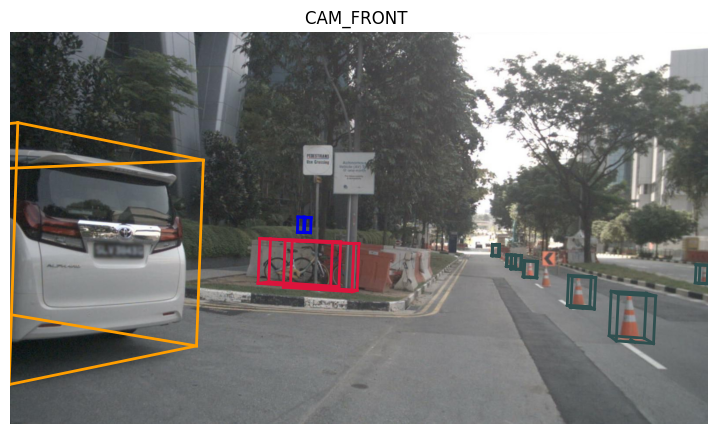

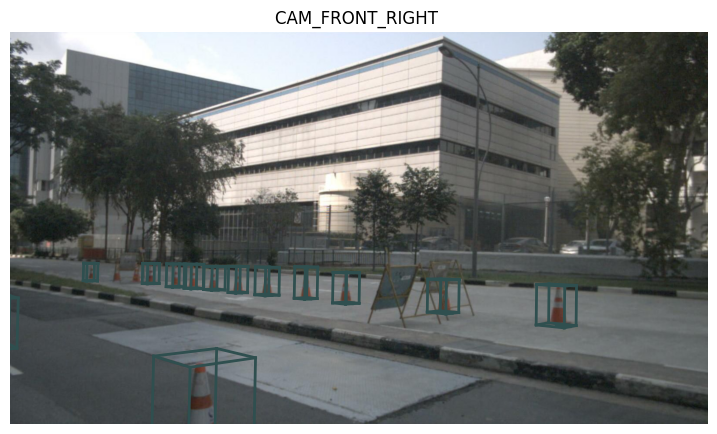

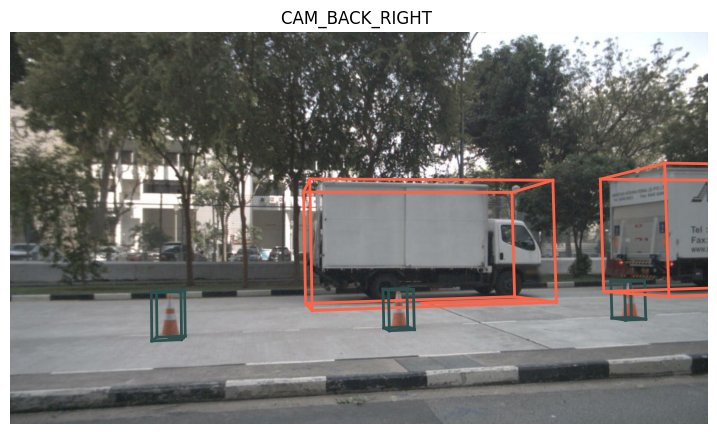

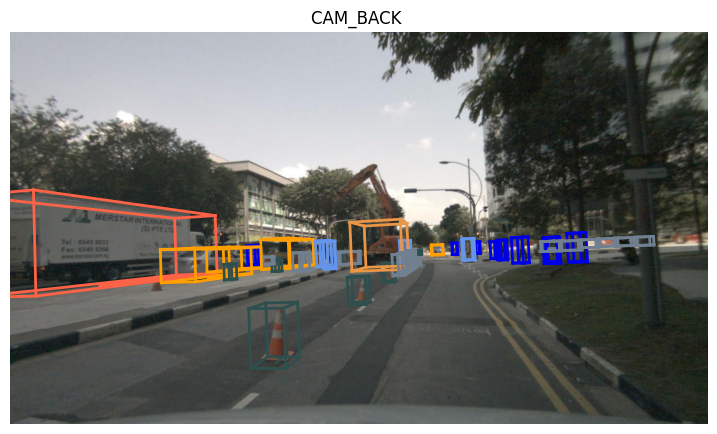

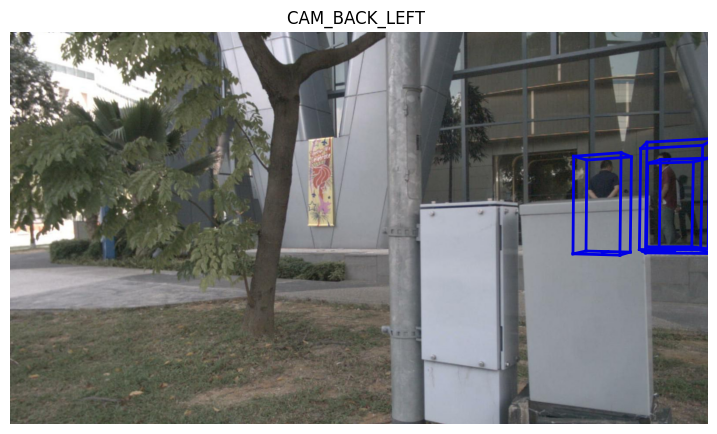

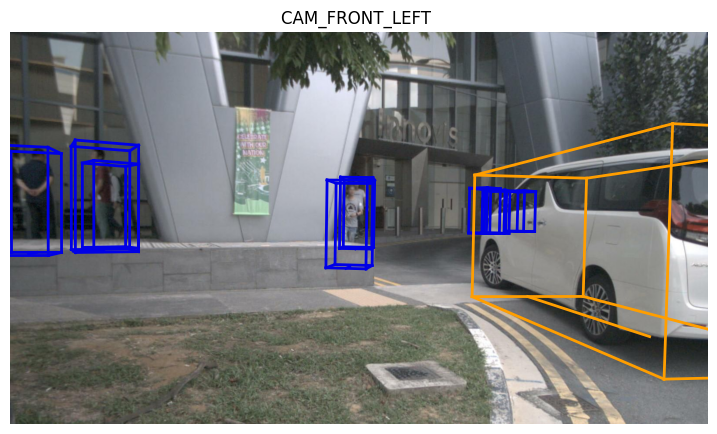

In [ ]:
# visualize same frame from different cameras

cameras = [
    'CAM_FRONT',
    'CAM_FRONT_RIGHT',
    'CAM_BACK_RIGHT',
    'CAM_BACK',
    'CAM_BACK_LEFT',
    'CAM_FRONT_LEFT'
]

for cam in cameras:
  cam_data = nusc.get('sample_data', my_sample['data'][cam])
  nusc.render_sample_data(cam_data['token'])

In [ ]:
# Q: investigate is_key_frame
cur_sample = first_sample_token
while cur_sample != '':
  is_key_frame = []
  my_sample = nusc.get('sample', cur_sample)

  for sensor in sensors:
    cam_data = nusc.get('sample_data', my_sample['data'][sensor])
    is_key_frame.append(cam_data['is_key_frame'])

  print(is_key_frame)
  cur_sample = my_sample['next']

[True, True, True, True, True, True, True, True, True, True, True, True]
[True, True, True, True, True, True, True, True, True, True, True, True]
[True, True, True, True, True, True, True, True, True, True, True, True]
[True, True, True, True, True, True, True, True, True, True, True, True]
[True, True, True, True, True, True, True, True, True, True, True, True]
[True, True, True, True, True, True, True, True, True, True, True, True]
[True, True, True, True, True, True, True, True, True, True, True, True]
[True, True, True, True, True, True, True, True, True, True, True, True]
[True, True, True, True, True, True, True, True, True, True, True, True]
[True, True, True, True, True, True, True, True, True, True, True, True]
[True, True, True, True, True, True, True, True, True, True, True, True]
[True, True, True, True, True, True, True, True, True, True, True, True]
[True, True, True, True, True, True, True, True, True, True, True, True]
[True, True, True, True, True, True, True, True, Tr

In [ ]:
# width & height
my_sample = nusc.get('sample', first_sample_token)
w_h = []
for sensor in sensors:
  cam_data = nusc.get('sample_data', my_sample['data'][sensor])
  print(f"{sensor.ljust(30)} : Width -> " + f"{cam_data['width']}".ljust(10) + f" || Height -> {cam_data['height']}")

RADAR_FRONT                    : Width -> 0          || Height -> 0
RADAR_FRONT_LEFT               : Width -> 0          || Height -> 0
RADAR_FRONT_RIGHT              : Width -> 0          || Height -> 0
RADAR_BACK_LEFT                : Width -> 0          || Height -> 0
RADAR_BACK_RIGHT               : Width -> 0          || Height -> 0
LIDAR_TOP                      : Width -> 0          || Height -> 0
CAM_FRONT                      : Width -> 1600       || Height -> 900
CAM_FRONT_RIGHT                : Width -> 1600       || Height -> 900
CAM_BACK_RIGHT                 : Width -> 1600       || Height -> 900
CAM_BACK                       : Width -> 1600       || Height -> 900
CAM_BACK_LEFT                  : Width -> 1600       || Height -> 900
CAM_FRONT_LEFT                 : Width -> 1600       || Height -> 900


In [ ]:
# get first scene frames paths
!tar zxvf /content/v1.0-mini.tgz

cam_front_path = "/content/samples/CAM_FRONT"
img_paths = os.listdir(cam_front_path)

unique_scenes = [*{*map(lambda x : x[:15], img_paths)}]
first_scene = unique_scenes[0]

first_scene_paths = []
for img_pth in img_paths:
  if first_scene in img_pth:
    first_scene_paths.append(img_pth)

first_scene_paths = sorted(first_scene_paths)
create_video(first_scene_paths, "first_scene.avi")

In [ ]:
!ffmpeg -i first_scene.avi -y output.mp4

from IPython.display import HTML
from base64 import b64encode
mp4 = open('output.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML("""
<video controls width="1080" height="576">
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
# Sensors vs. Timestamps
time_stamps = []
for sensor in sensors:
  sample_data_token = my_sample['data'][sensor]

  my_sample_data = nusc.get("sample_data", sample_data_token)

  ts = my_sample_data['timestamp']
  time_stamps.append(ts)

fig = go.Figure()
fig.add_trace(go.Scatter(y=time_stamps, x=sensors, name="Sensors"))

fig.update_layout(title="Sensors vs. Timestamps")

fig.show()



### 4. `sample_annotation`

`sample_annotation` refers to any ***bounding box defining the position of an object seen in a sample***. All location data is given with respect to the global coordinate system. Let's examine an example from our `sample` above.

sample_annotation
---------
A bounding box defining the position of an object seen in a sample.
All location data is given with respect to the global coordinate system.
```
sample_annotation {
   "token":                   <str> -- Unique record identifier.
   "sample_token":            <str> -- Foreign key. NOTE: this points to a sample NOT a sample_data since annotations are done on the sample level taking all relevant sample_data into account.
   "instance_token":          <str> -- Foreign key. Which object instance is this annotating. An instance can have multiple annotations over time.
   "attribute_tokens":        <str> [n] -- Foreign keys. List of attributes for this annotation. Attributes can change over time, so they belong here, not in the instance table.
   "visibility_token":        <str> -- Foreign key. Visibility may also change over time. If no visibility is annotated, the token is an empty string.
   "translation":             <float> [3] -- Bounding box location in meters as center_x, center_y, center_z.
   "size":                    <float> [3] -- Bounding box size in meters as width, length, height.
   "rotation":                <float> [4] -- Bounding box orientation as quaternion: w, x, y, z.
   "num_lidar_pts":           <int> -- Number of lidar points in this box. Points are counted during the lidar sweep identified with this sample.
   "num_radar_pts":           <int> -- Number of radar points in this box. Points are counted during the radar sweep identified with this sample. This number is summed across all radar sensors without any invalid point filtering.
   "next":                    <str> -- Foreign key. Sample annotation from the same object instance that follows this in time. Empty if this is the last annotation for this object.
   "prev":                    <str> -- Foreign key. Sample annotation from the same object instance that precedes this in time. Empty if this is the first annotation for this object.
}
```

In [ ]:
my_annotation_token = my_sample['anns'][0]
my_annotation_metadata =  nusc.get('sample_annotation', my_annotation_token)
my_annotation_metadata

{'token': '8bb63134d48840aaa2993f490855ff0d',
 'sample_token': 'ed5fc18c31904f96a8f0dbb99ff069c0',
 'instance_token': '6dd2cbf4c24b4caeb625035869bca7b5',
 'visibility_token': '3',
 'attribute_tokens': ['4d8821270b4a47e3a8a300cbec48188e'],
 'translation': [373.363, 1130.678, 1.15],
 'size': [0.621, 0.669, 1.642],
 'rotation': [0.9831098797903927, 0.0, 0.0, -0.18301629506281616],
 'prev': '93d5b79041c64693a5b32f1103a39a06',
 'next': '',
 'num_lidar_pts': 1,
 'num_radar_pts': 0,
 'category_name': 'human.pedestrian.adult'}

We can also render an annotation to have a closer look.

/usr/local/lib/python3.10/dist-packages/nuscenes/nuscenes.py:1493: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



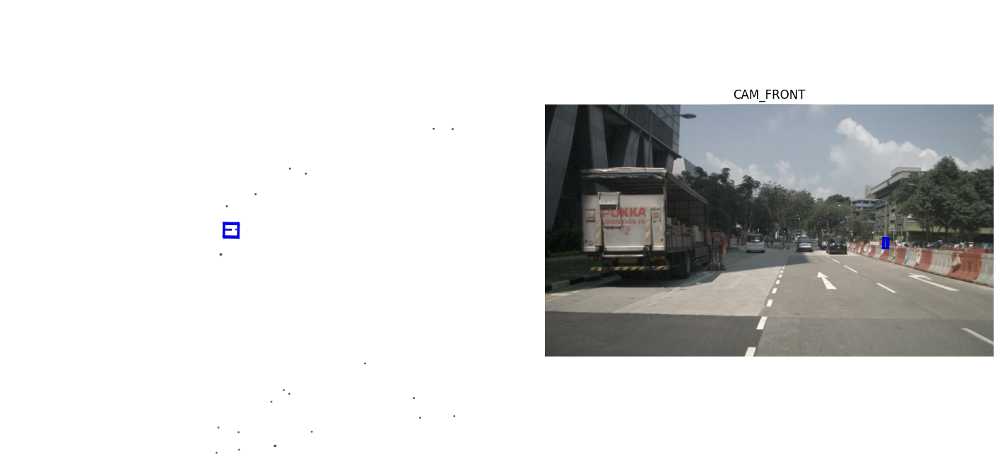

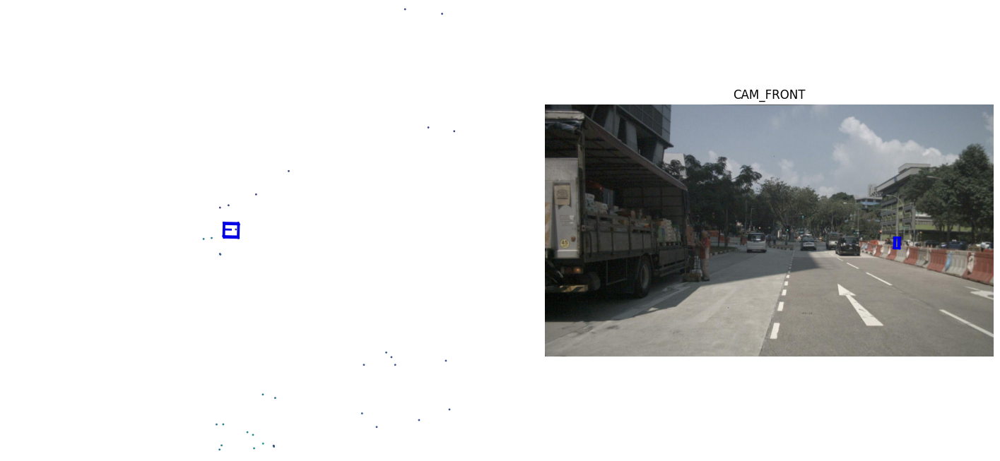

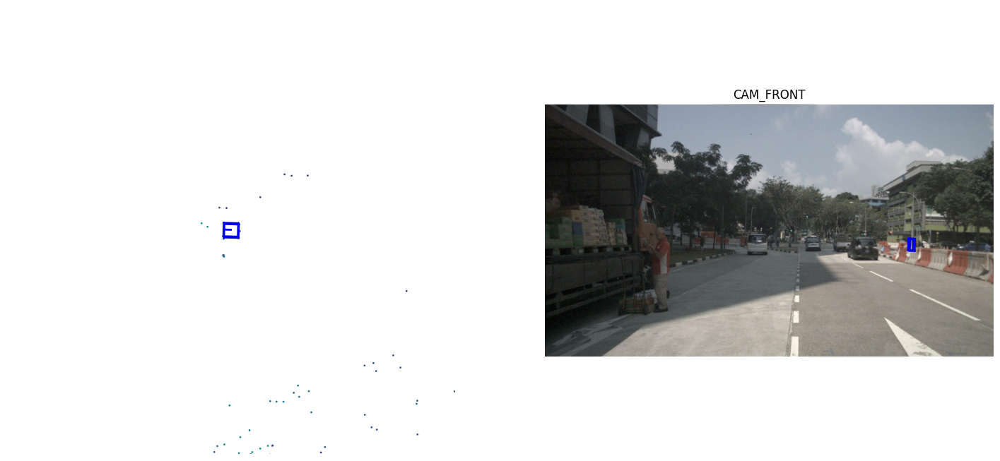

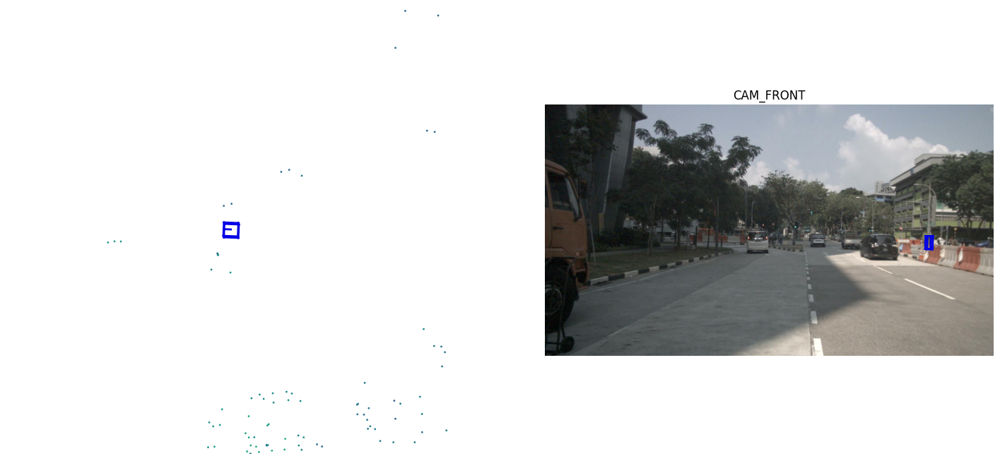

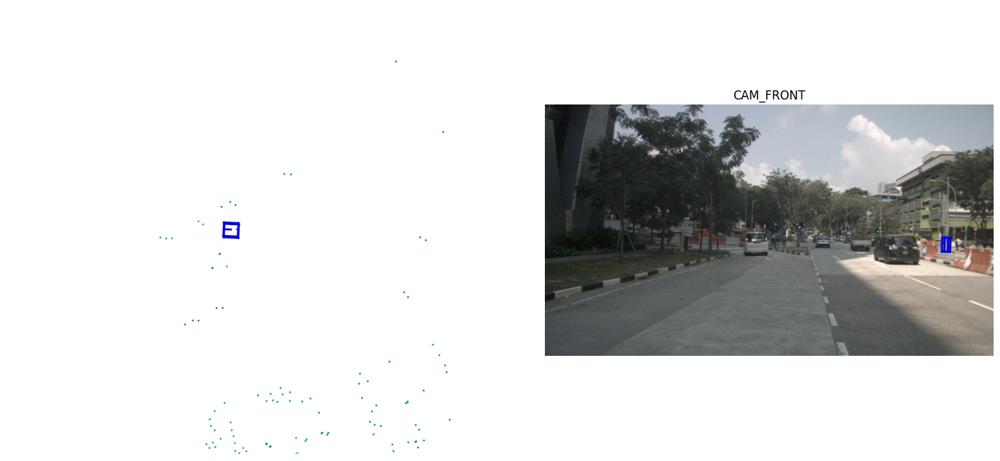

...

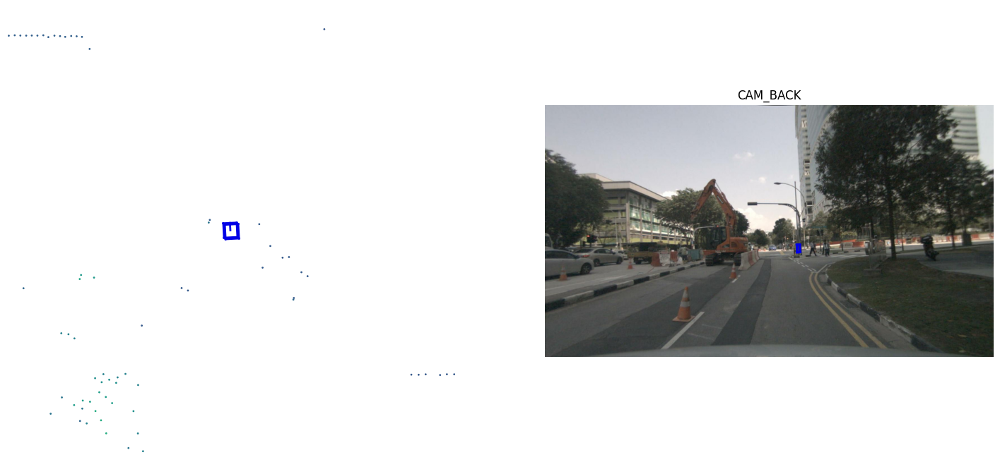

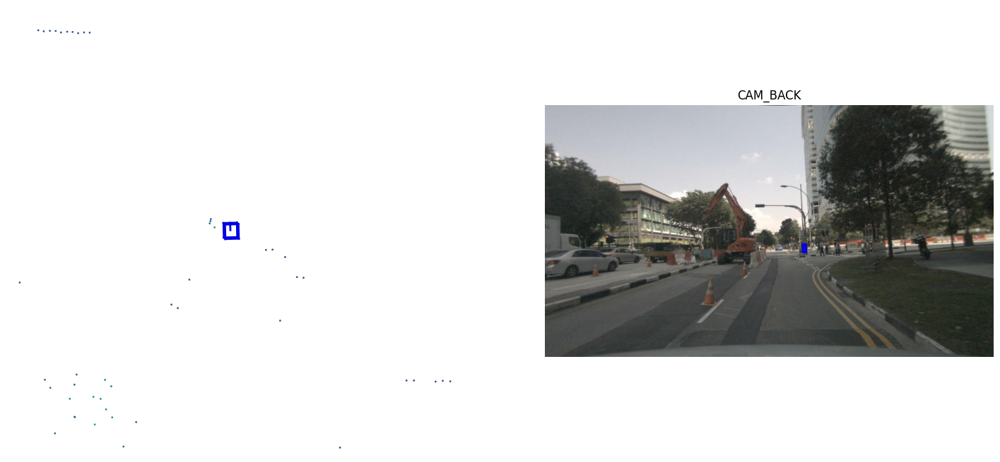

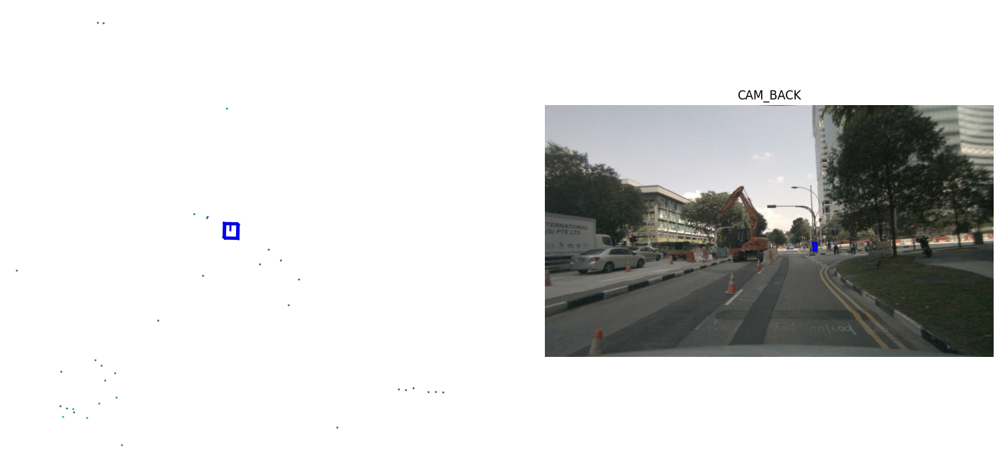

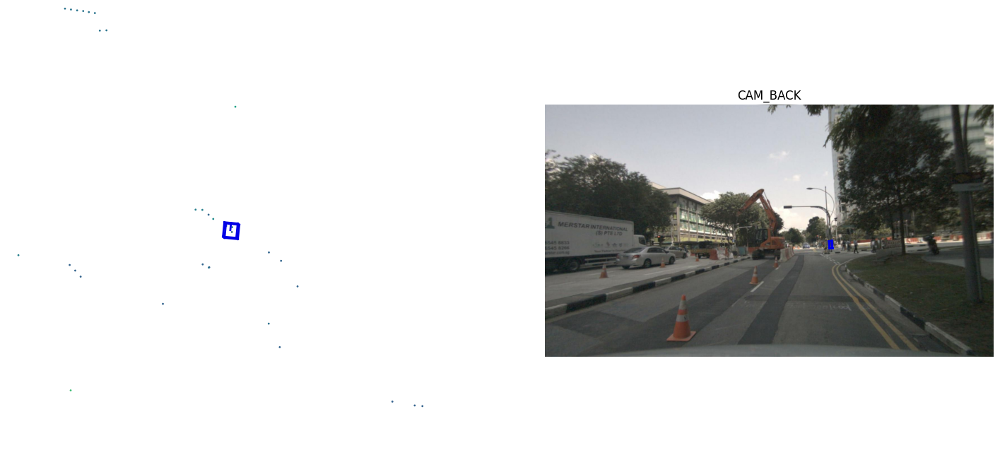

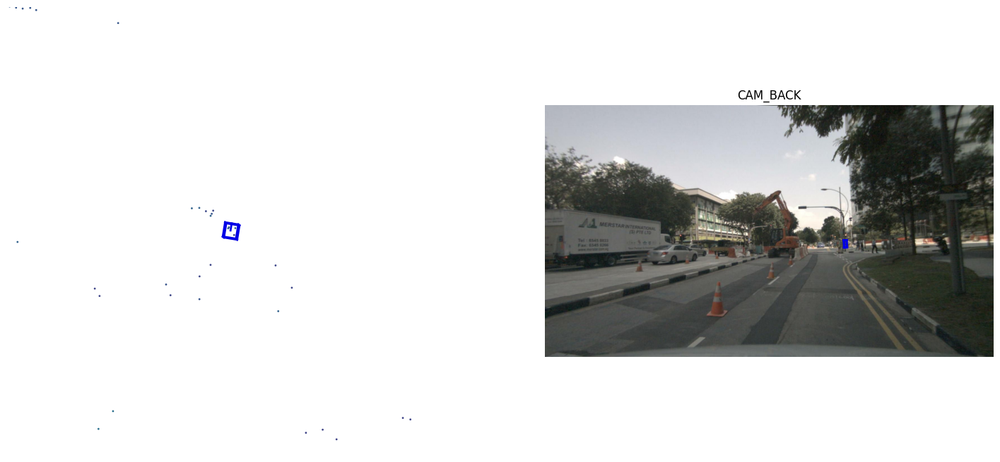

In [ ]:
cur_annot = my_annotation_token

while cur_annot != '':
  annotation = nusc.get('sample_annotation', cur_annot)
  nusc.render_annotation(annotation['token'])
  cur_annot = annotation['next']

### 5. `instance`

```
instance {
   "token":                   <str> -- Unique record identifier.
   "category_token":          <str> -- Foreign key pointing to the object category.
   "nbr_annotations":         <int> -- Number of annotations of this instance.
   "first_annotation_token":  <str> -- Foreign key. Points to the first annotation of this instance.
   "last_annotation_token":   <str> -- Foreign key. Points to the last annotation of this instance.
}
```


Object instance are instances that need to be detected or tracked by an AV (e.g a particular vehicle, pedestrian). Let us examine an instance metadata

In [ ]:
instance = nusc.get('instance', "6dd2cbf4c24b4caeb625035869bca7b5")
instance

{'token': '6dd2cbf4c24b4caeb625035869bca7b5',
 'category_token': '1fa93b757fc74fb197cdd60001ad8abf',
 'nbr_annotations': 39,
 'first_annotation_token': 'ef63a697930c4b20a6b9791f423351da',
 'last_annotation_token': '8bb63134d48840aaa2993f490855ff0d'}

In [ ]:
my_instance = nusc.instance[599]
my_instance

{'token': '9cba9cd8af85487fb010652c90d845b5',
 'category_token': 'fedb11688db84088883945752e480c2c',
 'nbr_annotations': 16,
 'first_annotation_token': '77afa772cb4a4e5c8a5a53f2019bdba0',
 'last_annotation_token': '6fed6d902e5e487abb7444f62e1a2341'}

We generally track an instance across different frames in a particular scene. However, we do not track them across different scenes. In this example, we have 16 annotated samples for this instance across a particular scene.

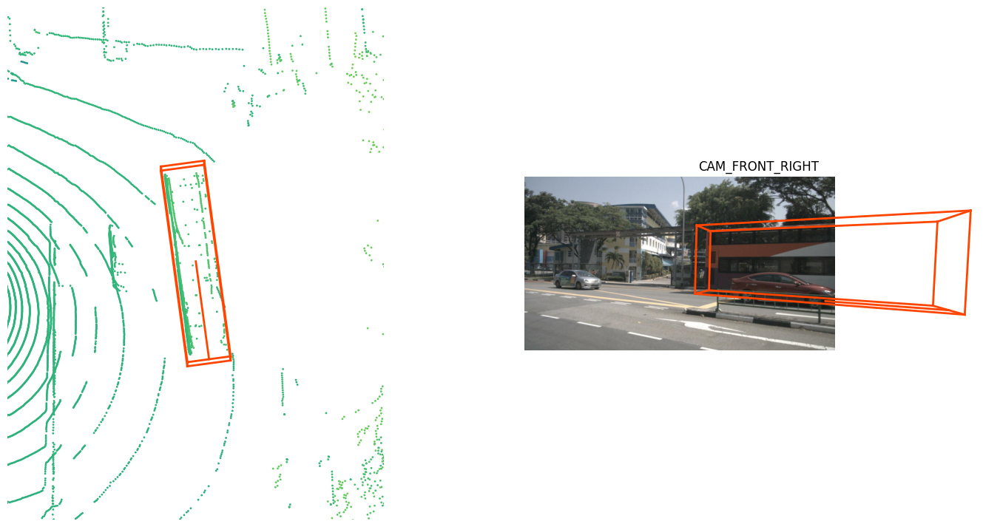

In [ ]:
instance_token = my_instance['token']
nusc.render_instance(instance_token)

An instance record takes note of its first and last annotation token. Let's render them

First annotated sample of this instance:


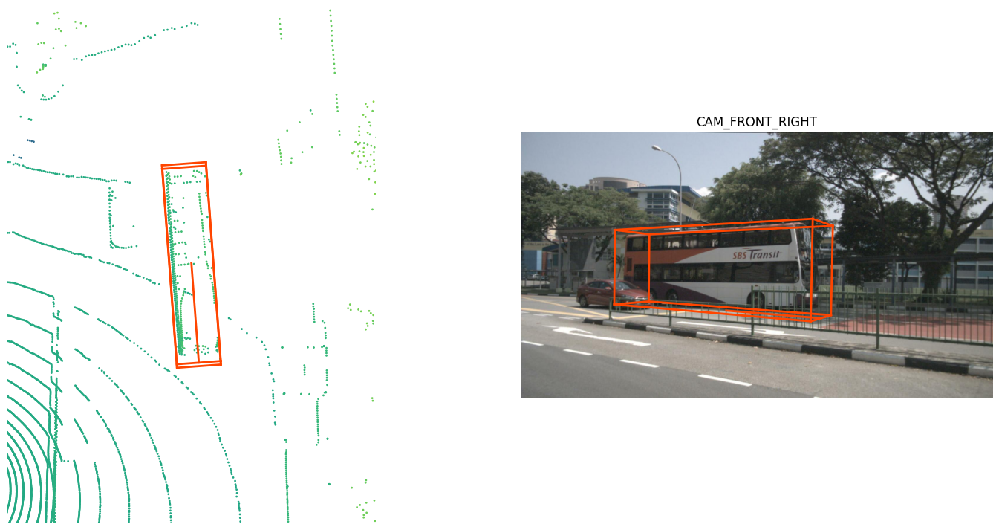

In [ ]:
print("First annotated sample of this instance:")
nusc.render_annotation(my_instance['first_annotation_token'])

Last annotated sample of this instance


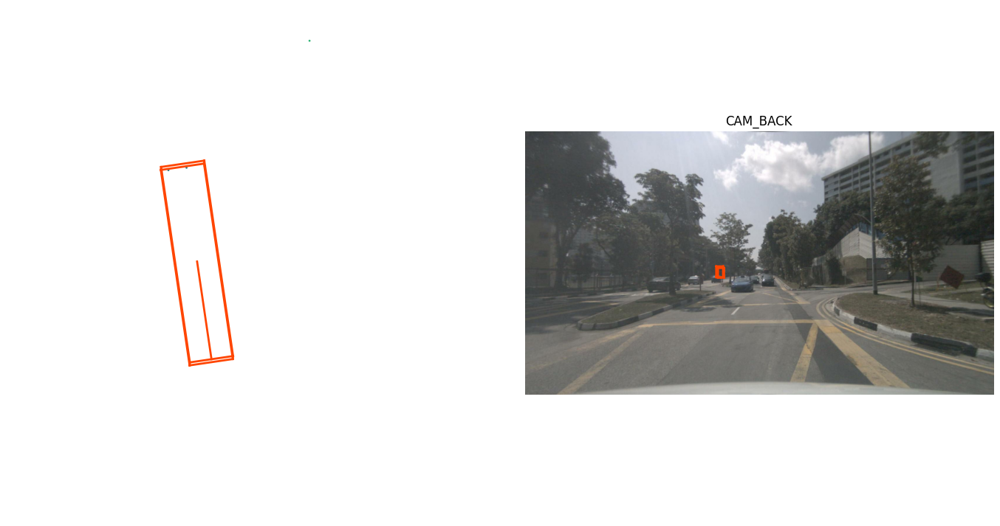

In [ ]:
print("Last annotated sample of this instance")
nusc.render_annotation(my_instance['last_annotation_token'])

### 6. `category`

```
category {
   "token":                   <str> -- Unique record identifier.
   "name":                    <str> -- Category name. Subcategories indicated by period.
   "description":             <str> -- Category description.
   "index":                   <int> -- The index of the label used for efficiency reasons in the .bin label files of nuScenes-lidarseg. This field did not exist previously.
}
```

A `category` is the object assignment of an annotation.  Let's look at the category table we have in our database. The table contains the taxonomy of different object categories and also list the subcategories (delineated by a period).

In [ ]:
nusc.list_categories() # Number of categories : 23

Category stats for split v1.0-mini:
human.pedestrian.adult      n= 4765, width= 0.68±0.11, len= 0.73±0.17, height= 1.76±0.12, lw_aspect= 1.08±0.23
human.pedestrian.child      n=   46, width= 0.46±0.08, len= 0.45±0.09, height= 1.37±0.06, lw_aspect= 0.97±0.05
human.pedestrian.constructi n=  193, width= 0.69±0.07, len= 0.74±0.12, height= 1.78±0.05, lw_aspect= 1.07±0.16
human.pedestrian.personal_m n=   25, width= 0.83±0.00, len= 1.28±0.00, height= 1.87±0.00, lw_aspect= 1.55±0.00
human.pedestrian.police_off n=   11, width= 0.59±0.00, len= 0.47±0.00, height= 1.81±0.00, lw_aspect= 0.80±0.00
movable_object.barrier      n= 2323, width= 2.32±0.49, len= 0.61±0.11, height= 1.06±0.10, lw_aspect= 0.28±0.09
movable_object.debris       n=   13, width= 0.43±0.00, len= 1.43±0.00, height= 0.46±0.00, lw_aspect= 3.35±0.00
movable_object.pushable_pul n=   82, width= 0.51±0.06, len= 0.79±0.10, height= 1.04±0.20, lw_aspect= 1.55±0.18
movable_object.trafficcone  n= 1378, width= 0.47±0.14, len= 0.45±0.07, heigh

A category record contains the name and the description of that particular category.

In [ ]:
nusc.category[9]

{'token': 'dfd26f200ade4d24b540184e16050022',
 'name': 'vehicle.motorcycle',
 'description': 'Gasoline or electric powered 2-wheeled vehicle designed to move rapidly (at the speed of standard cars) on the road surface. This category includes all motorcycles, vespas and scooters.'}

Refer to `instructions_nuscenes.md` for the definitions of the different categories.

### 7. `attribute`

```
attribute {
   "token":                   <str> -- Unique record identifier.
   "name":                    <str> -- Attribute name.
   "description":             <str> -- Attribute description.
}
```

An `attribute` is a property of an instance that may change throughout different parts of a scene while the category remains the same. Here we list the provided attributes and the number of annotations associated with a particular attribute.

In [ ]:
nusc.list_attributes()

cycle.with_rider: 305
cycle.without_rider: 434
pedestrian.moving: 3875
pedestrian.sitting_lying_down: 111
pedestrian.standing: 1029
vehicle.moving: 2715
vehicle.parked: 4674
vehicle.stopped: 1545


Let's take a look at an example how an attribute may change over one scene

In [ ]:
my_instance = nusc.instance[27]
first_token = my_instance['first_annotation_token']
last_token = my_instance['last_annotation_token']
nbr_samples = my_instance['nbr_annotations']
current_token = first_token

i = 0
found_change = False
while current_token != last_token:
    current_ann = nusc.get('sample_annotation', current_token)
    current_attr = nusc.get('attribute', current_ann['attribute_tokens'][0])['name']

    if i == 0:
        pass
    elif current_attr != last_attr:
        print("Changed from `{}` to `{}` at timestamp {} out of {} annotated timestamps".format(last_attr, current_attr, i, nbr_samples))
        found_change = True

    next_token = current_ann['next']
    current_token = next_token
    last_attr = current_attr
    i += 1

Changed from `pedestrian.moving` to `pedestrian.standing` at timestamp 21 out of 39 annotated timestamps


### 8. `visibility`

```
visibility {
   "token":                   <str> -- Unique record identifier.
   "level":                   <str> -- Visibility level.
   "description":             <str> -- Description of visibility level.
}
```

`visibility` is defined as the fraction of pixels of a particular annotation that are visible over the 6 camera feeds, grouped into 4 bins.

In [ ]:
nusc.visibility

[{'description': 'visibility of whole object is between 0 and 40%',
  'token': '1',
  'level': 'v0-40'},
 {'description': 'visibility of whole object is between 40 and 60%',
  'token': '2',
  'level': 'v40-60'},
 {'description': 'visibility of whole object is between 60 and 80%',
  'token': '3',
  'level': 'v60-80'},
 {'description': 'visibility of whole object is between 80 and 100%',
  'token': '4',
  'level': 'v80-100'}]

Let's look at an example `sample_annotation` with 80-100% visibility

Visibility: {'description': 'visibility of whole object is between 80 and 100%', 'token': '4', 'level': 'v80-100'}


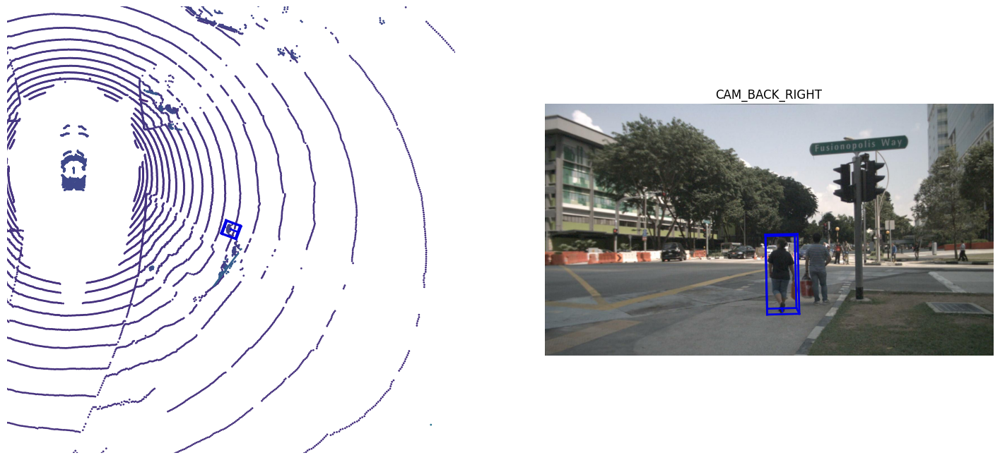

In [ ]:
anntoken = 'a7d0722bce164f88adf03ada491ea0ba'
visibility_token = nusc.get('sample_annotation', anntoken)['visibility_token']

print("Visibility: {}".format(nusc.get('visibility', visibility_token)))
nusc.render_annotation(anntoken)

Let's look at an example `sample_annotation` with 0-40% visibility

Visibility: {'description': 'visibility of whole object is between 0 and 40%', 'token': '1', 'level': 'v0-40'}


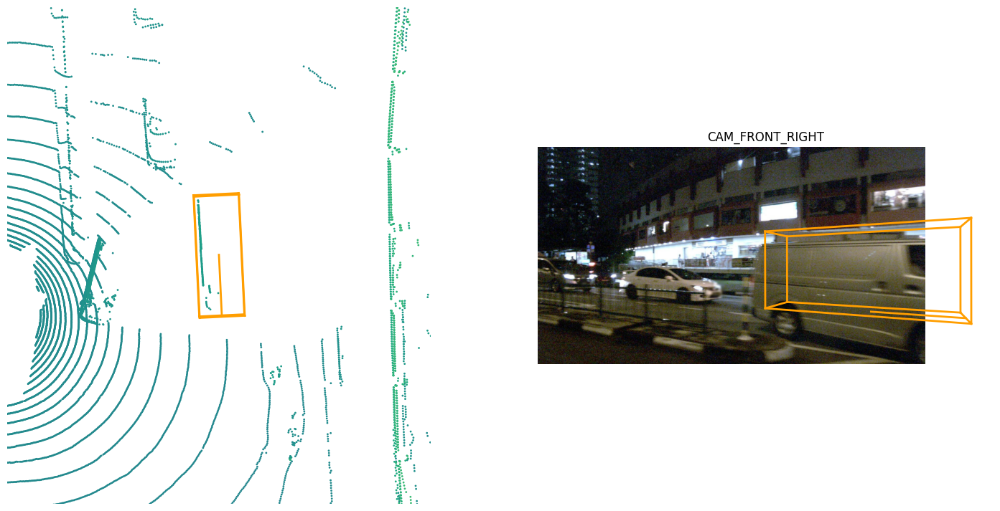

In [ ]:
anntoken = '9f450bf6b7454551bbbc9a4c6e74ef2e'
visibility_token = nusc.get('sample_annotation', anntoken)['visibility_token']

print("Visibility: {}".format(nusc.get('visibility', visibility_token)))
nusc.render_annotation(anntoken)

### 9. `sensor`

```
sensor {
   "token":                   <str> -- Unique record identifier.
   "channel":                 <str> -- Sensor channel name.
   "modality":                <str> {camera, lidar, radar} -- Sensor modality. Supports category(ies) in brackets.
}
```

The nuScenes dataset consists of data collected from our full sensor suite which consists of:
- 1 x LIDAR,
- 5 x RADAR,
- 6 x cameras,

In [ ]:
nusc.sensor

[{'token': '725903f5b62f56118f4094b46a4470d8',
  'channel': 'CAM_FRONT',
  'modality': 'camera'},
 {'token': 'ce89d4f3050b5892b33b3d328c5e82a3',
  'channel': 'CAM_BACK',
  'modality': 'camera'},
 {'token': 'a89643a5de885c6486df2232dc954da2',
  'channel': 'CAM_BACK_LEFT',
  'modality': 'camera'},
 {'token': 'ec4b5d41840a509984f7ec36419d4c09',
  'channel': 'CAM_FRONT_LEFT',
  'modality': 'camera'},
 {'token': '2f7ad058f1ac5557bf321c7543758f43',
  'channel': 'CAM_FRONT_RIGHT',
  'modality': 'camera'},
 {'token': 'ca7dba2ec9f95951bbe67246f7f2c3f7',
  'channel': 'CAM_BACK_RIGHT',
  'modality': 'camera'},
 {'token': 'dc8b396651c05aedbb9cdaae573bb567',
  'channel': 'LIDAR_TOP',
  'modality': 'lidar'},
 {'token': '47fcd48f71d75e0da5c8c1704a9bfe0a',
  'channel': 'RADAR_FRONT',
  'modality': 'radar'},
 {'token': '232a6c4dc628532e81de1c57120876e9',
  'channel': 'RADAR_FRONT_RIGHT',
  'modality': 'radar'},
 {'token': '1f69f87a4e175e5ba1d03e2e6d9bcd27',
  'channel': 'RADAR_FRONT_LEFT',
  'modality'

Every `sample_data` has a record on which `sensor` the data is collected from (note the "channel" key)

### 10. `calibrated_sensor`

```
calibrated_sensor {
   "token":                   <str> -- Unique record identifier.
   "sensor_token":            <str> -- Foreign key pointing to the sensor type.
   "translation":             <float> [3] -- Coordinate system origin in meters: x, y, z.
   "rotation":                <float> [4] -- Coordinate system orientation as quaternion: w, x, y, z.
   "camera_intrinsic":        <float> [3, 3] -- Intrinsic camera calibration. Empty for sensors that are not cameras.
}
```

`calibrated_sensor` consists of the definition of a particular sensor (lidar/radar/camera) as calibrated on a particular vehicle. Let us look at an example.

In [ ]:
nusc.calibrated_sensor[0]

{'token': 'f4d2a6c281f34a7eb8bb033d82321f79',
 'sensor_token': '47fcd48f71d75e0da5c8c1704a9bfe0a',
 'translation': [3.412, 0.0, 0.5],
 'rotation': [0.9999984769132877, 0.0, 0.0, 0.0017453283658983088],
 'camera_intrinsic': []}

Note that the `translation` and the `rotation` parameters are given with respect to the ego vehicle body frame.

### 11. `ego_pose`

```
ego_pose {
   "token":                   <str> -- Unique record identifier.
   "translation":             <float> [3] -- Coordinate system origin in meters: x, y, z. Note that z is always 0.
   "rotation":                <float> [4] -- Coordinate system orientation as quaternion: w, x, y, z.
   "timestamp":               <int> -- Unix time stamp.
}
```

`ego_pose` contains information about the location (encoded in `translation`) and the orientation (encoded in `rotation`) of the ego vehicle, with respect to the global coordinate system.

In [ ]:
# translation of same ego in same sample

trans = []

for sensor in sensors:
  sample_data_token = my_sample['data'][sensor]
  sample_data_obj = nusc.get('sample_data', sample_data_token)

  ego_pose_token = sample_data_obj['ego_pose_token']

  ego_pose_obj = nusc.get('ego_pose', ego_pose_token)
  trans.append(ego_pose_obj['translation'])

Note that the number of `ego_pose` records in our loaded database is the same as the number of `sample_data` records. These two records exhibit a one-to-one correspondence.

### 12. `log`

```
log {
   "token":                   <str> -- Unique record identifier.
   "logfile":                 <str> -- Log file name.
   "vehicle":                 <str> -- Vehicle name.
   "date_captured":           <str> -- Date (YYYY-MM-DD).
   "location":                <str> -- Area where log was captured, e.g. singapore-onenorth.
}
```

The `log` table contains log information from which the data was extracted. A `log` record corresponds to one journey of our ego vehicle along a predefined route. Let's check the number of logs and the metadata of a log.

In [ ]:
print("Number of `logs` in our loaded database: {}".format(len(nusc.log)))

Number of `logs` in our loaded database: 8


In [ ]:
nusc.log[0]

{'token': '7e25a2c8ea1f41c5b0da1e69ecfa71a2',
 'logfile': 'n015-2018-07-24-11-22-45+0800',
 'vehicle': 'n015',
 'date_captured': '2018-07-24',
 'location': 'singapore-onenorth',
 'map_token': '53992ee3023e5494b90c316c183be829'}

Notice that it contains a variety of information such as the date and location of the log collected. It also gives out information about the map from where the data was collected. Note that one log can contain multiple non-overlapping scenes.

### 13. `map`

```
map {
   "token":                   <str> -- Unique record identifier.
   "log_tokens":              <str> [n] -- Foreign keys.
   "category":                <str> -- Map category, currently only semantic_prior for drivable surface and sidewalk.
   "filename":                <str> -- Relative path to the file with the map mask.
}
```


Map information is stored as binary semantic masks from a top-down view. Let's check the number of maps and metadata of a map.

In [ ]:
print("There are {} maps masks in the loaded dataset".format(len(nusc.map)))

There are 4 maps masks in the loaded dataset


In [ ]:
nusc.map[0]

{'category': 'semantic_prior',
 'token': '53992ee3023e5494b90c316c183be829',
 'filename': 'maps/53992ee3023e5494b90c316c183be829.png',
 'log_tokens': ['0986cb758b1d43fdaa051ab23d45582b',
  '1c9b302455ff44a9a290c372b31aa3ce',
  'e60234ec7c324789ac7c8441a5e49731',
  '46123a03f41e4657adc82ed9ddbe0ba2',
  'a5bb7f9dd1884f1ea0de299caefe7ef4',
  'bc41a49366734ebf978d6a71981537dc',
  'f8699afb7a2247e38549e4d250b4581b',
  'd0450edaed4a46f898403f45fa9e5f0d',
  'f38ef5a1e9c941aabb2155768670b92a',
  '7e25a2c8ea1f41c5b0da1e69ecfa71a2',
  'ddc03471df3e4c9bb9663629a4097743',
  '31e9939f05c1485b88a8f68ad2cf9fa4',
  '783683d957054175bda1b326453a13f4',
  '343d984344e440c7952d1e403b572b2a',
  '92af2609d31445e5a71b2d895376fed6',
  '47620afea3c443f6a761e885273cb531',
  'd31dc715d1c34b99bd5afb0e3aea26ed',
  '34d0574ea8f340179c82162c6ac069bc',
  'd7fd2bb9696d43af901326664e42340b',
  'b5622d4dcb0d4549b813b3ffb96fbdc9',
  'da04ae0b72024818a6219d8dd138ea4b',
  '6b6513e6c8384cec88775cae30b78c0e',
  'eda311bda86f

## nuScenes Basics

Let's get a bit technical.

The NuScenes class holds several tables. Each table is a list of records, and each record is a dictionary. For example the first record of the category table is stored at:

In [ ]:
nusc.category[0]

The category table is simple: it holds the fields `name` and `description`. It also has a `token` field, which is a unique record identifier. Since the record is a dictionary, the token can be accessed like so:

In [ ]:
cat_token = nusc.category[0]['token']
cat_token

If you know the `token` for any record in the DB you can retrieve the record by doing

In [ ]:
nusc.get('category', cat_token)

_As you can notice, we have recovered the same record!_

OK, that was easy. Let's try something harder. Let's look at the `sample_annotation` table.

In [ ]:
nusc.sample_annotation[0]

This also has a `token` field (they all do). In addition, it has several fields of the format [a-z]*\_token, _e.g._ instance_token. These are foreign keys in database terminology, meaning they point to another table.
Using `nusc.get()` we can grab any of these in constant time. For example, let's look at the visibility record.

In [ ]:
nusc.get('visibility', nusc.sample_annotation[0]['visibility_token'])

The visibility records indicate how much of an object was visible when it was annotated.

Let's also grab the `instance_token`

In [ ]:
one_instance = nusc.get('instance', nusc.sample_annotation[0]['instance_token'])
one_instance

This points to the `instance` table. This table enumerate the object _instances_ we have encountered in each
scene. This way we can connect all annotations of a particular object.

If you look carefully at the README tables, you will see that the sample_annotation table points to the instance table,
but the instance table doesn't list all annotations that point to it.

So how can we recover all sample_annotations for a particular object instance? There are two ways:

1. `Use nusc.field2token()`. Let's try it:

In [ ]:
ann_tokens = nusc.field2token('sample_annotation', 'instance_token', one_instance['token'])

This returns a list of all sample_annotation records with the `'instance_token'` == `one_instance['token']`. Let's store these in a set for now

In [ ]:
ann_tokens_field2token = set(ann_tokens)

ann_tokens_field2token

The `nusc.field2token()` method is generic and can be used in any similar situation.

2. For certain situation, we provide some reverse indices in the tables themselves. This is one such example.

The instance record has a field `first_annotation_token` which points to the first annotation in time of this instance.
Recovering this record is easy.

In [ ]:
ann_record = nusc.get('sample_annotation', one_instance['first_annotation_token'])
ann_record

Now we can traverse all annotations of this instance using the "next" field. Let's try it.

In [ ]:
ann_tokens_traverse = set()
ann_tokens_traverse.add(ann_record['token'])
while not ann_record['next'] == "":
    ann_record = nusc.get('sample_annotation', ann_record['next'])
    ann_tokens_traverse.add(ann_record['token'])

Finally, let's assert that we recovered the same ann_records as we did using nusc.field2token:

In [ ]:
print(ann_tokens_traverse == ann_tokens_field2token)

## Reverse indexing and short-cuts

The nuScenes tables are normalized, meaning that each piece of information is only given once.
For example, there is one `map` record for each `log` record. Looking at the schema you will notice that the `map` table has a `log_token` field, but that the `log` table does not have a corresponding `map_token` field. But there are plenty of situations where you have a `log`, and want to find the corresponding `map`! So what to do? You can always use the `nusc.field2token()` method, but that is slow and inconvenient. We therefore add reverse mappings for some common situations including this one.

Further, there are situations where one needs to go through several tables to get a certain piece of information.
Consider, for example, the category name (e.g. `human.pedestrian`) of a `sample_annotation`. The `sample_annotation` table doesn't hold this information since the category is an instance level constant. Instead the `sample_annotation` table points to a record in the `instance` table. This, in turn, points to a record in the `category` table, where finally the `name` fields stores the required information.

Since it is quite common to want to know the category name of an annotation, we add a `category_name` field to the `sample_annotation` table during initialization of the NuScenes class.

In this section, we list the short-cuts and reverse indices that are added to the `NuScenes` class during initialization. These are all created in the `NuScenes.__make_reverse_index__()` method.

### Reverse indices
We add two reverse indices by default.
* A `map_token` field is added to the `log` records.
* The `sample` records have shortcuts to all `sample_annotations` for that record as well as `sample_data` key-frames. Confer `nusc.list_sample()` method in the previous section for more details on this.

### Shortcuts

The sample_annotation table has a "category_name" shortcut.

_Using shortcut:_

In [ ]:
catname = nusc.sample_annotation[0]['category_name']

_Not using shortcut:_

In [ ]:
ann_rec = nusc.sample_annotation[0]
inst_rec = nusc.get('instance', ann_rec['instance_token'])
cat_rec = nusc.get('category', inst_rec['category_token'])

print(catname == cat_rec['name'])

The sample_data table has "channel" and "sensor_modality" shortcuts:

In [ ]:
# Shortcut
channel = nusc.sample_data[0]['channel']

# No shortcut
sd_rec = nusc.sample_data[0]
cs_record = nusc.get('calibrated_sensor', sd_rec['calibrated_sensor_token'])
sensor_record = nusc.get('sensor', cs_record['sensor_token'])

print(channel == sensor_record['channel'])

True


## Data Visualizations

We provide list and rendering methods. These are meant both as convenience methods during development, and as tutorials for building your own visualization methods. They are implemented in the NuScenesExplorer class, with shortcuts through the NuScenes class itself.

### List methods
There are three list methods available.

1. `list_categories()` lists all categories, counts and statistics of width/length/height in meters and aspect ratio.

In [ ]:
nusc.list_categories()

Category stats for split v1.0-mini:
human.pedestrian.adult      n= 4765, width= 0.68±0.11, len= 0.73±0.17, height= 1.76±0.12, lw_aspect= 1.08±0.23
human.pedestrian.child      n=   46, width= 0.46±0.08, len= 0.45±0.09, height= 1.37±0.06, lw_aspect= 0.97±0.05
human.pedestrian.constructi n=  193, width= 0.69±0.07, len= 0.74±0.12, height= 1.78±0.05, lw_aspect= 1.07±0.16
human.pedestrian.personal_m n=   25, width= 0.83±0.00, len= 1.28±0.00, height= 1.87±0.00, lw_aspect= 1.55±0.00
human.pedestrian.police_off n=   11, width= 0.59±0.00, len= 0.47±0.00, height= 1.81±0.00, lw_aspect= 0.80±0.00
movable_object.barrier      n= 2323, width= 2.32±0.49, len= 0.61±0.11, height= 1.06±0.10, lw_aspect= 0.28±0.09
movable_object.debris       n=   13, width= 0.43±0.00, len= 1.43±0.00, height= 0.46±0.00, lw_aspect= 3.35±0.00
movable_object.pushable_pul n=   82, width= 0.51±0.06, len= 0.79±0.10, height= 1.04±0.20, lw_aspect= 1.55±0.18
movable_object.trafficcone  n= 1378, width= 0.47±0.14, len= 0.45±0.07, heigh

2. `list_attributes()` lists all attributes and counts.

In [ ]:
nusc.list_attributes()

cycle.with_rider: 305
cycle.without_rider: 434
pedestrian.moving: 3875
pedestrian.sitting_lying_down: 111
pedestrian.standing: 1029
vehicle.moving: 2715
vehicle.parked: 4674
vehicle.stopped: 1545


3. `list_scenes()` lists all scenes in the loaded DB.

In [ ]:
nusc.list_scenes()

scene-0061, Parked truck, construction, intersectio... [18-07-24 03:28:47]   19s, singapore-onenorth, #anns:4622
scene-0103, Many peds right, wait for turning car, ... [18-08-01 19:26:43]   19s, boston-seaport, #anns:2046
scene-0655, Parking lot, parked cars, jaywalker, be... [18-08-27 15:51:32]   20s, boston-seaport, #anns:2332
scene-0553, Wait at intersection, bicycle, large tr... [18-08-28 20:48:16]   20s, boston-seaport, #anns:1950
scene-0757, Arrive at busy intersection, bus, wait ... [18-08-30 19:25:08]   20s, boston-seaport, #anns:592
scene-0796, Scooter, peds on sidewalk, bus, cars, t... [18-10-02 02:52:24]   20s, singapore-queensto, #anns:708
scene-0916, Parking lot, bicycle rack, parked bicyc... [18-10-08 07:37:13]   20s, singapore-queensto, #anns:2387
scene-1077, Night, big street, bus stop, high speed... [18-11-21 11:39:27]   20s, singapore-hollandv, #anns:890
scene-1094, Night, after rain, many peds, PMD, ped ... [18-11-21 11:47:27]   19s, singapore-hollandv, #anns:1762
sc

### Render

First, let's plot a lidar point cloud in an image. Lidar allows us to accurately map the surroundings in 3D.

AttributeError: ignored

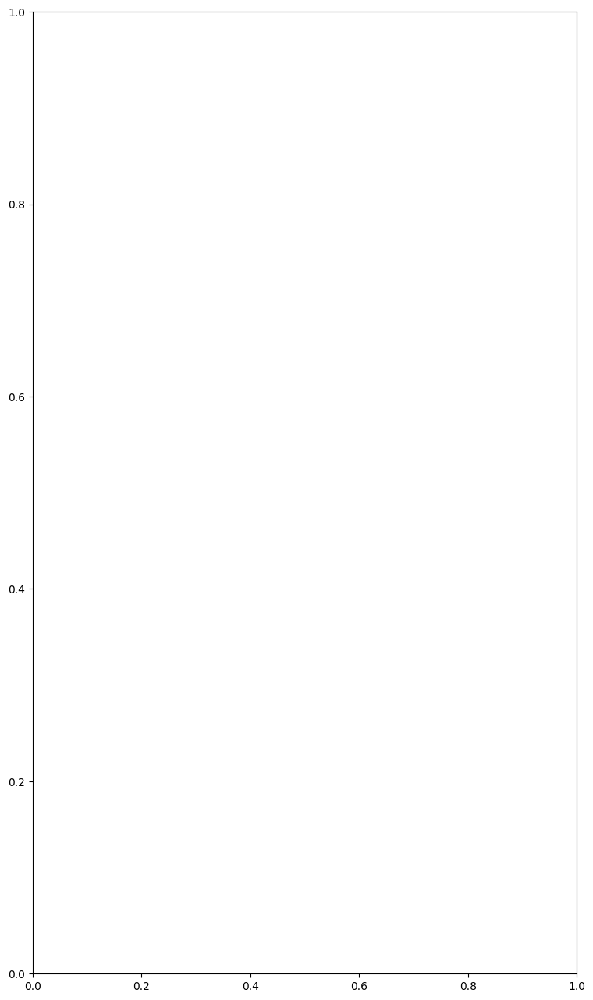

In [ ]:
my_sample = nusc.sample[10]
nusc.render_pointcloud_in_image(my_sample['token'], pointsensor_channel='LIDAR_TOP')

In the previous image the colors indicate the distance from the ego vehicle to each lidar point. We can also render the lidar intensity. In the following image the traffic sign ahead of us is highly reflective (yellow) and the dark vehicle on the right has low reflectivity (purple).

AttributeError: ignored

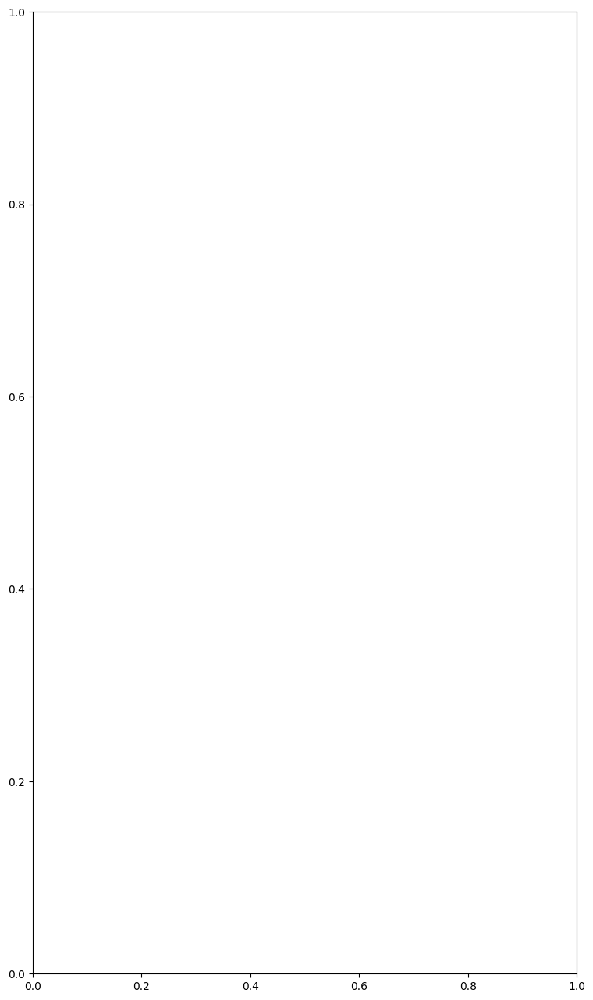

In [ ]:
nusc.render_pointcloud_in_image(my_sample['token'], pointsensor_channel='LIDAR_TOP', render_intensity=True)

Second, let's plot the radar point cloud for the same image. Radar is less dense than lidar, but has a much larger range.

In [ ]:
nusc.render_pointcloud_in_image(my_sample['token'], pointsensor_channel='RADAR_FRONT')

We can also plot all annotations across all sample data for that sample. Note how for radar we also plot the velocity vectors of moving objects. Some velocity vectors are outliers, which can be filtered using the settings in RadarPointCloud.from_file()

In [ ]:
my_sample = nusc.sample[20]

# The rendering command below is commented out because it may crash in notebooks
# nusc.render_sample(my_sample['token'])

Or if we only want to render a particular sensor, we can specify that.

In [ ]:
nusc.render_sample_data(my_sample['data']['CAM_FRONT'])

Additionally we can aggregate the point clouds from multiple sweeps to get a denser point cloud.

In [ ]:
nusc.render_sample_data(my_sample['data']['LIDAR_TOP'], nsweeps=5, underlay_map=True)
nusc.render_sample_data(my_sample['data']['RADAR_FRONT'], nsweeps=5, underlay_map=True)

In the radar plot above we only see very confident radar returns from two vehicles. This is due to the filter settings defined in the file `nuscenes/utils/data_classes.py`. If instead we want to disable all filters and render all returns, we can use the `disable_filters()` function. This returns a denser point cloud, but with many returns from background objects. To return to the default settings, simply call `default_filters()`.

In [ ]:
from nuscenes.utils.data_classes import RadarPointCloud
RadarPointCloud.disable_filters()
nusc.render_sample_data(my_sample['data']['RADAR_FRONT'], nsweeps=5, underlay_map=True)
RadarPointCloud.default_filters()

We can even render a specific annotation.

In [ ]:
nusc.render_annotation(my_sample['anns'][22])

Finally, we can render a full scene as a video. There are two options here:
1. nusc.render_scene_channel() renders the video for a particular channel. (HIT ESC to exit)
2. nusc.render_scene() renders the video for all camera channels.

NOTE: These methods use OpenCV for rendering, which doesn't always play nice with IPython Notebooks. If you experience any issues please run these lines from the command line.

Let's grab scene 0061, it is nice and dense.

In [ ]:
my_scene_token = nusc.field2token('scene', 'name', 'scene-0061')[0]

In [ ]:
# The rendering command below is commented out because it may crash in notebooks
# nusc.render_scene_channel(my_scene_token, 'CAM_FRONT')

There is also a method nusc.render_scene() which renders the video for all camera channels.
This requires a high-res monitor, and is also best run outside this notebook.

In [ ]:
# The rendering command below is commented out because it may crash in notebooks
# nusc.render_scene(my_scene_token)

Finally, let us visualize all scenes on the map for a particular location.

In [ ]:
nusc.render_egoposes_on_map(log_location='singapore-onenorth')